# Concours Data is for Good : aidons Paris à devenir une smart-city !

## Contexte

Dans le cadre du programme "Végétalisons la ville" organisé par la ville de Paris, nous proposons ici une analyse exploratoire des données OpenData concernant les arbres gérés par la ville de Paris.

L'objectif est d'aider Paris à devenir une "Smart-City" en gérant ses arbres de la manière la plus responsable possible. C'est-à-dire en optimisant les trajets nécessaires pour entretenir ces arbres.


## Outils utilisés

Nous allons utiliser le langage Python, et présenter ici le code, les résultats et l'analyse sous forme de [Notebook Jupyter](https://jupyter-notebook.readthedocs.io/en/stable/notebook.html).

Nous allons aussi utiliser les bibliothèques usuelles d'exploration et analyse de données, afin d'améliorer la simplicité et la performance de notre code :
* [NumPy](https://numpy.org/doc/stable/user/quickstart.html) : effectuer des calculs scientifiques (statistiques, algèbre, ...)
* [Pandas](https://pandas.pydata.org/docs/user_guide/index.html) : manipuler des données volumineuses et complexes
* [Matplotlib](https://matplotlib.org/stable/tutorials/introductory/usage.html), [Pyplot](https://matplotlib.org/stable/tutorials/introductory/pyplot.html), [Seaborne](https://seaborn.pydata.org/tutorial/function_overview.html) et [Plotly](https://plotly.com/python/getting-started/) : générer des graphiques lisibles, intéractifs et pertinents


In [3]:
# Import libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


## Chargement des données et premier aperçu

Les données mises à disposition sont issues de  [opendata.paris.fr](https://opendata.paris.fr/explore/dataset/les-arbres/information/) et représentent "l’ensemble des arbres, ainsi que les arbres d’alignement, présents sur le territoire parisien et des cimetières extra-muros (hors de Paris)."



Nous allons dans un premier temps simplement charger les données en mémoire et observer quelques valeurs.

In [4]:
# load raw data into a Pandas DataFrame, separator is ";"
data = pd.read_csv("data/p2-arbres-fr.csv", sep=';')

# display first 5 rows
data.head()


,id,type_emplacement,domanialite,arrondissement,complement_addresse,numero,lieu,id_emplacement,libelle_francais,genre,espece,variete,circonference_cm,hauteur_m,stade_developpement,remarquable,geo_point_2d_a,geo_point_2d_b
0,99874,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,19,Marronnier,Aesculus,hippocastanum,NaN,20,5,NaN,0.0,48.857620,2.320962
1,99875,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,20,If,Taxus,baccata,NaN,65,8,A,NaN,48.857656,2.321031
2,99876,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,21,If,Taxus,baccata,NaN,90,10,A,NaN,48.857705,2.321061
3,99877,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,22,Erable,Acer,negundo,NaN,60,8,A,NaN,48.857722,2.321006
4,99878,Arbre,Jardin,PARIS 17E ARRDT,NaN,NaN,PARC CLICHY-BATIGNOLLES-MARTIN LUTHER KING,000G0037,Arbre à miel,Tetradium,daniellii,NaN,38,0,NaN,NaN,48.890435,2.315289


Nous voyons que, pour chaque arbre listé, nous disposons des informations suivantes (la description des colonnes est disponible sur le site [OpenData](https://opendata.paris.fr/explore/dataset/les-arbres/information/)) :
- `id` : simple identifiant de l'arbre (entier, ex. : `99874`)
- `type_emplacement` : type de l'emplacement (texte, ex. : `"Arbre"`)
- `domanialite` : type de lieu auquel appartient l'arbre (texte, ex. : `"Jardin"`)
- `arrondissement` : arrondissement de Paris où est situé l'arbre (texte, ex. : `"PARIS 7E ARRDT"`)
- `complement_addresse` : complement d'adress (texte, pas d'exemple visible)
- `numero` : numéro de l'adress (texte, pas d'exemple visible)
- `lieu` : adresse de l'arbre (texte, ex. : `"MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E"`)
- `id_emplacement` : identifiant de l'emplacement (texte, ex. : `"19"`)
- `libelle_francais` : nom commun (vernaculaire) de l'espèce de l'arbre (texte, ex. : `"Marronnier"`)
- `genre` : genre de l'arbre (texte, ex. : `"Aesculus"`)
- `espece` : espèce de l'arbre (texte, ex. : `"hippocastanum"`)
- `variete` : variété de l'arbre (texte, pas d'exemple visible)
- `circonference_cm` : circonférence en centimètres de l'arbre (entier, ex. : `20`)
- `hauteur_m` : taille en mètres de l'arbre (entier, ex. : `5`)
- `stade_developpement` : stade de développement de l'arbre (texte, ex. : `"A"` pour "Adulte")
- `remarquable` : si l'arbre est "remarquable" ou non (booléen, ex. : `0` pour un arbre "non remarquable")
- `geo_point_2d_a` : latitude de la position de l'arbre (nombre à virgule, ex. : `48.857620`)
- `geo_point_2d_b` : longitude de la position de l'arbre (nombre à virgule, ex. : `2.320962`)

Nous voyons déjà que parmis les quelques premières données :
- un certain certain nombre de valeurs ne sont pas fournies (`NaN` = "Not a Number" = donnée non disponible)
- certaines valeurs sont numériques, d'autres textuelles
- on peut classer les données en trois grandes catégories, d'après leur sens :
    - métadonnées internes au système : `id`, `id_emplacement`, `type_emplacement`
    - données de localisation : `arrondissement`, `complement_addresse`, `numero`, `lieu`, `geo_point_2d_a`, `geo_point_2d_b`
    - données de description : `libelle_francais`, `genre`, `espece`, `variete`, `circonference_cm`, `hauteur_m`, `stade_developpement`, `remarquable`


## Première analyse statistique

Nous allons maintenant chercher à comprendre comment sont réparties les valeurs pour chaque caractéristique de nos arbres.

Une simple description statistique de chaque colonne nous donne les informations suivantes :


In [73]:
data.describe(include="all")

,id,type_emplacement,domanialite,arrondissement,complement_addresse,numero,lieu,id_emplacement,libelle_francais,genre,espece,variete,circonference_cm,hauteur_m,stade_developpement,remarquable,geo_point_2d_a,geo_point_2d_b
count,2.001370e+05,200137,200136,200137,30902,0.0,200137,200137,198640,200121,198385,36777,200137.000000,200137.000000,132932,137039.000000,200137.000000,200137.000000
unique,NaN,1,9,25,3795,NaN,6921,69040,192,175,539,436,NaN,NaN,4,NaN,NaN,NaN
top,NaN,Arbre,Alignement,PARIS 15E ARRDT,SN°,NaN,PARC FLORAL DE PARIS / ROUTE DE LA PYRAMIDE,101001,Platane,Platanus,x hispanica,Baumannii',NaN,NaN,A,NaN,NaN,NaN
freq,NaN,200137,104949,17151,557,NaN,2995,1324,42508,42591,36409,4538,NaN,NaN,64438,NaN,NaN,NaN
mean,3.872027e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.380479,13.110509,NaN,0.001343,48.854491,2.348208
std,5.456032e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,673.190213,1971.217387,NaN,0.036618,0.030234,0.051220
min,9.987400e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,NaN,0.000000,48.742290,2.210241
25%,1.559270e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30.000000,5.000000,NaN,0.000000,48.835021,2.307530
50%,2.210780e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,70.000000,8.000000,NaN,0.000000,48.854162,2.351095
75%,2.741020e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,115.000000,12.000000,NaN,0.000000,48.876447,2.386838


Pour chaque donnée numérique (`id`, `circonference_cm`, `hauteur_m`, `remarquable`, `geo_point_2d_a` et `geo_point_2d_b`), nous obtenons :
- le nombre de valeurs non vides (`count`)
- la moyenne (`mean`)
- l'écart-type (`std`)
- les valeurs minimale (`min`) et maximale (`max`)
- les 25, 50 (médiane) et 75 centiles (`25%`, `50%` et `75%`)

Pour chaque donnée textuelle (`type_emplacement`, `domanialite`, `arrondissement`, `complement_addresse`, `lieu`, `id_emplacement`, `libelle_francais`, `genre`, `espece`, `variete` et `stade_developpement`), nous obtenons :
- le nombre de valeurs non vides (`count`)
- le nombre de valeurs différentes (`unique`)
- la valeur la plus représentée (`top`)
- la fréquence de la valeur la plus représentée (`freq`)


Nous voyons alors que :
- la colonne `numero` n'est jamais renseignée (`count=0`)
    - ce critère n'apporte donc pas d'information
- il n'y a qu'un type d'emplacement possible (`type_emplacement` : `freq=count=200137`) : `"Arbre"`
    - ce critère n'apporte donc pas d'information
- les colonnes `complement_addresse` (`count=30902`) et `variete` (`count=36777`) sont très peu renseignées (> 80% de valeurs non définies)
    - les informations apportées par ces colonnes seront donc très difficilement exploitables en l'état
- les colonnes `stade_developpement` (`count=132932`) et `remarquable` (`count=137039`) sont partiellement renseignées (> 30% de valeurs non définies)
    - les informations apportées par ces colonnes seront donc pas facilement exploitables en l'état
- les colonnes `libelle_francais` (`count=198640`) et `espece` (`count=198385`) sont pas toujours renseignées (> 0,5% de valeurs non définies)
    - les informations apportées par ces colonnes sont assez fiables, mais il faudra faire attention aux cas non renseignés
- les données de `circonference_cm` et `hauteur_m` ont des valeurs aberrantes dont il faudra tenir compte :
    - `minimum=0` , ce qui semble impossible
    - `circonference_cm` : `maximum=250255` et `hauteur_m` : `maximum=881818` , ce qui semble impossible

In [74]:

data = data.dropna(axis="columns")
data.head()

,id,type_emplacement,arrondissement,lieu,id_emplacement,circonference_cm,hauteur_m,geo_point_2d_a,geo_point_2d_b
0,99874,Arbre,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,19,20,5,48.857620,2.320962
1,99875,Arbre,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,20,65,8,48.857656,2.321031
2,99876,Arbre,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,21,90,10,48.857705,2.321061
3,99877,Arbre,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,22,60,8,48.857722,2.321006
4,99878,Arbre,PARIS 17E ARRDT,PARC CLICHY-BATIGNOLLES-MARTIN LUTHER KING,000G0037,38,0,48.890435,2.315289


In [75]:
data.describe(include="all")


,id,type_emplacement,arrondissement,lieu,id_emplacement,circonference_cm,hauteur_m,geo_point_2d_a,geo_point_2d_b
count,2.001370e+05,200137,200137,200137,200137,200137.000000,200137.000000,200137.000000,200137.000000
unique,NaN,1,25,6921,69040,NaN,NaN,NaN,NaN
top,NaN,Arbre,PARIS 15E ARRDT,PARC FLORAL DE PARIS / ROUTE DE LA PYRAMIDE,101001,NaN,NaN,NaN,NaN
freq,NaN,200137,17151,2995,1324,NaN,NaN,NaN,NaN
mean,3.872027e+05,NaN,NaN,NaN,NaN,83.380479,13.110509,48.854491,2.348208
std,5.456032e+05,NaN,NaN,NaN,NaN,673.190213,1971.217387,0.030234,0.051220
min,9.987400e+04,NaN,NaN,NaN,NaN,0.000000,0.000000,48.742290,2.210241
25%,1.559270e+05,NaN,NaN,NaN,NaN,30.000000,5.000000,48.835021,2.307530
50%,2.210780e+05,NaN,NaN,NaN,NaN,70.000000,8.000000,48.854162,2.351095
75%,2.741020e+05,NaN,NaN,NaN,NaN,115.000000,12.000000,48.876447,2.386838


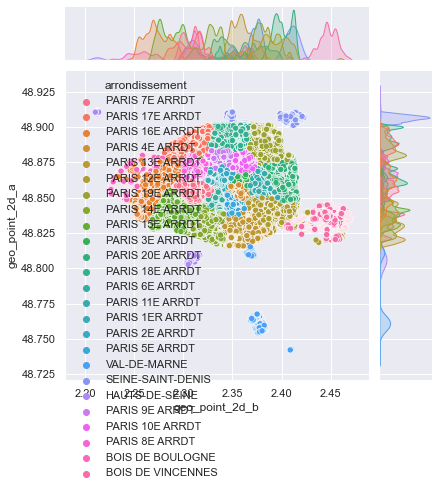

In [76]:
sns.jointplot(
    data=data,
    x="geo_point_2d_b", y="geo_point_2d_a", hue="arrondissement",
)

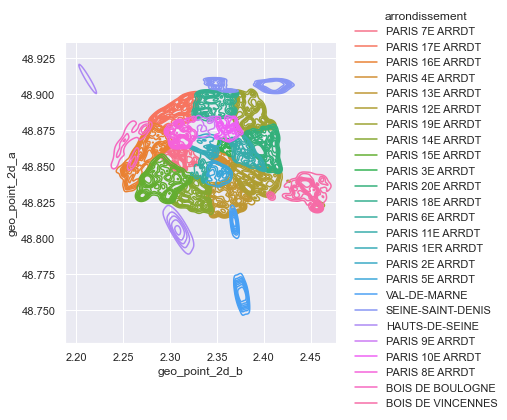

In [77]:
sns.displot(
    data=data, 
    x="geo_point_2d_b", y="geo_point_2d_a", hue="arrondissement", kind="kde"
)
